Data shape for benin: (525600, 19)


,Timestamp,GHI,DNI,DHI,ModA,ModB,Tamb,RH,WS,WSgust,WSstdev,WD,WDstdev,BP,Cleaning,Precipitation,TModA,TModB,Comments
0,2021-08-09 00:01,-1.2,-0.2,-1.1,0.0,0.0,26.2,93.4,0.0,0.4,0.1,122.1,0.0,998,0,0.0,26.3,26.2,NaN
1,2021-08-09 00:02,-1.1,-0.2,-1.1,0.0,0.0,26.2,93.6,0.0,0.0,0.0,0.0,0.0,998,0,0.0,26.3,26.2,NaN
2,2021-08-09 00:03,-1.1,-0.2,-1.1,0.0,0.0,26.2,93.7,0.3,1.1,0.5,124.6,1.5,997,0,0.0,26.4,26.2,NaN
3,2021-08-09 00:04,-1.1,-0.1,-1.0,0.0,0.0,26.2,93.3,0.2,0.7,0.4,120.3,1.3,997,0,0.0,26.4,26.3,NaN
4,2021-08-09 00:05,-1.0,-0.1,-1.0,0.0,0.0,26.2,93.3,0.1,0.7,0.3,113.2,1.0,997,0,0.0,26.4,26.3,NaN


Numeric summary:
                  GHI            DNI            DHI           ModA  \
count  525600.000000  525600.000000  525600.000000  525600.000000   
mean      240.559452     167.187516     115.358961     236.589496   
std       331.131327     261.710501     158.691074     326.894859   
min       -12.900000      -7.800000     -12.600000       0.000000   
25%        -2.000000      -0.500000      -2.100000       0.000000   
50%         1.800000      -0.100000       1.600000       4.500000   
75%       483.400000     314.200000     216.300000     463.700000   
max      1413.000000     952.300000     759.200000    1342.300000   

                ModB           Tamb             RH             WS  \
count  525600.000000  525600.000000  525600.000000  525600.000000   
mean      228.883576      28.179683      54.487969       2.121113   
std       316.536515       5.924297      28.073069       1.603466   
min         0.000000      11.000000       2.100000       0.000000   
25%         0.0

C:\Users\Y.com\AppData\Local\Temp\ipykernel_5532\3667065368.py:55: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[col].fillna(median_val, inplace=True)


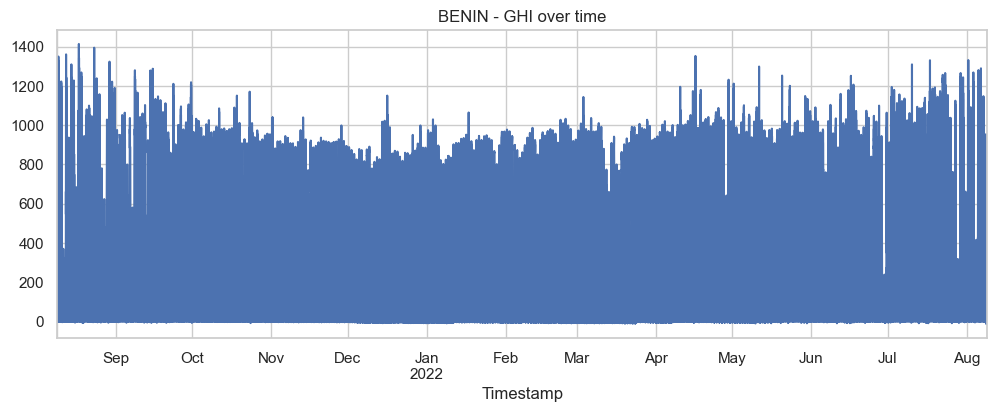

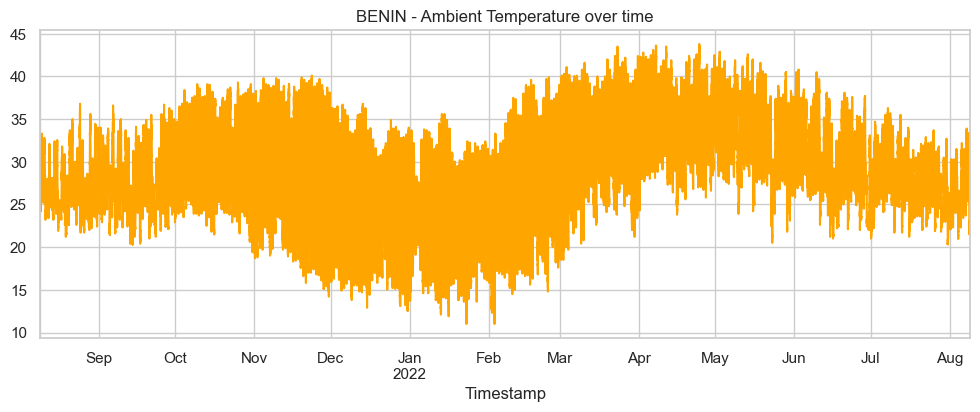

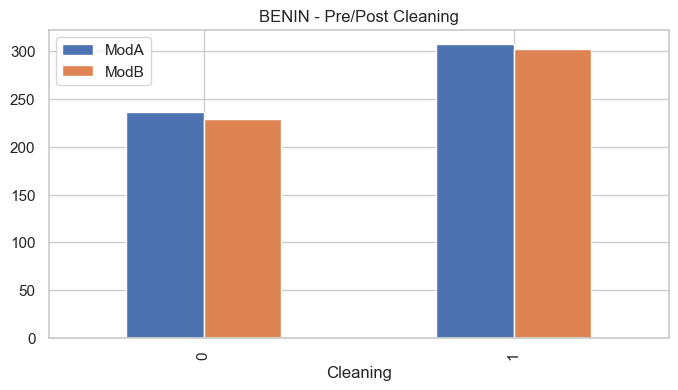

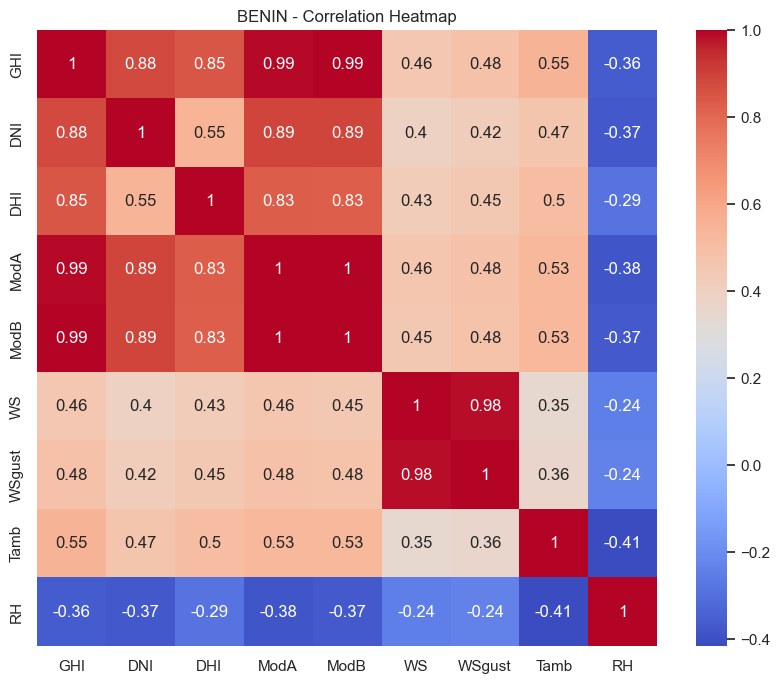

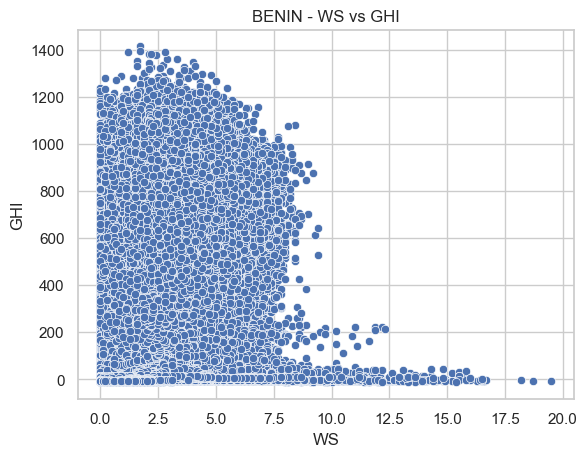

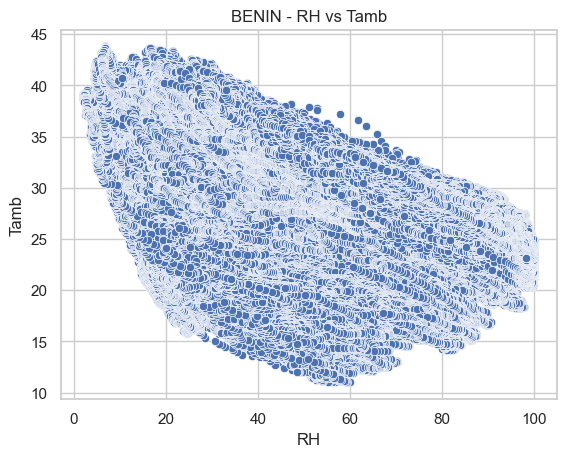

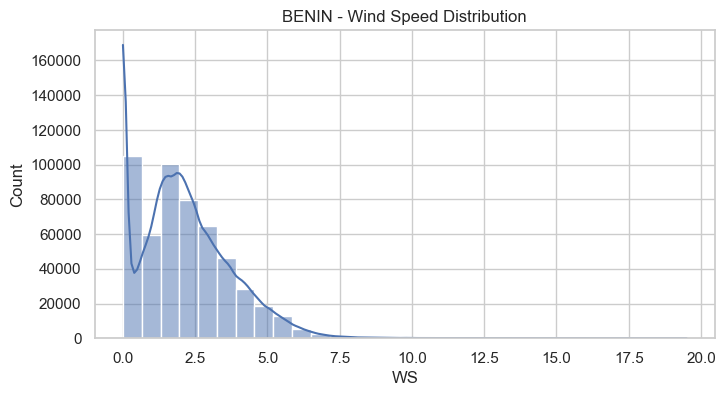

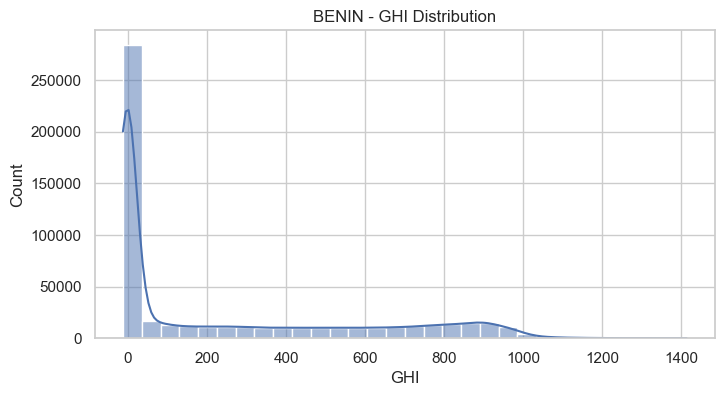

c:\Users\Y.com\Anaconda3\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


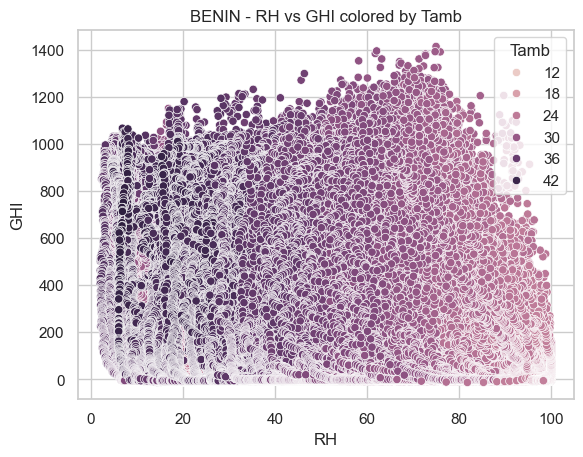

Cleaned data exported to ../data/benin_clean.csv


In [4]:
# =========================
# Task 2: Country EDA Template
# =========================

# 0. Setup
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
import plotly.express as px
import os

# Set display options
pd.set_option('display.max_columns', None)
sns.set(style='whitegrid')

# -------------------------
# 1. Load Data
# -------------------------
country = 'benin'  
raw_path = f'../data/{country}.csv'  # Ensure your raw CSVs are here
if not os.path.exists(raw_path):
    raise FileNotFoundError(f"{raw_path} not found. Please place your raw CSV there.")

df = pd.read_csv(raw_path)
print(f"Data shape for {country}: {df.shape}")
display(df.head())

# -------------------------
# 2. Summary Statistics & Missing Values
# -------------------------
print("Numeric summary:\n", df.describe())
print("\nMissing values:\n", df.isna().sum())

# List columns with >5% missing
missing_pct = df.isna().mean() * 100
print("\nColumns with >5% missing values:")
print(missing_pct[missing_pct > 5])

# -------------------------
# 3. Outlier Detection & Cleaning
# -------------------------
cols_to_check = ['GHI', 'DNI', 'DHI', 'ModA', 'ModB', 'WS', 'WSgust']

# Z-score method
z_scores = np.abs(stats.zscore(df[cols_to_check], nan_policy='omit'))
outliers = (z_scores > 3)
print("\nNumber of outliers per column:")
print(pd.DataFrame(outliers).sum())

# Impute missing values with median
for col in cols_to_check:
    median_val = df[col].median()
    df[col].fillna(median_val, inplace=True)

# -------------------------
# 4. Time Series Analysis
# -------------------------
df['Timestamp'] = pd.to_datetime(df['Timestamp'])
df.set_index('Timestamp', inplace=True)

# Line plot: GHI over time
plt.figure(figsize=(12,4))
df['GHI'].plot(title=f"{country.upper()} - GHI over time")
plt.show()

# Line plot: Tamb over time
plt.figure(figsize=(12,4))
df['Tamb'].plot(title=f"{country.upper()} - Ambient Temperature over time", color='orange')
plt.show()

# -------------------------
# 5. Cleaning Impact
# -------------------------
if 'Cleaning' in df.columns:
    df.groupby('Cleaning')[['ModA', 'ModB']].mean().plot(
        kind='bar', figsize=(8,4), title=f"{country.upper()} - Pre/Post Cleaning"
    )
    plt.show()

# -------------------------
# 6. Correlation & Relationship Analysis
# -------------------------
corr_cols = ['GHI','DNI','DHI','ModA','ModB','WS','WSgust','Tamb','RH']
plt.figure(figsize=(10,8))
sns.heatmap(df[corr_cols].corr(), annot=True, cmap='coolwarm')
plt.title(f"{country.upper()} - Correlation Heatmap")
plt.show()

# Scatter plots
sns.scatterplot(data=df, x='WS', y='GHI')
plt.title(f"{country.upper()} - WS vs GHI")
plt.show()

sns.scatterplot(data=df, x='RH', y='Tamb')
plt.title(f"{country.upper()} - RH vs Tamb")
plt.show()

# -------------------------
# 7. Wind & Distribution Analysis
# -------------------------
plt.figure(figsize=(8,4))
sns.histplot(df['WS'], bins=30, kde=True)
plt.title(f"{country.upper()} - Wind Speed Distribution")
plt.show()

plt.figure(figsize=(8,4))
sns.histplot(df['GHI'], bins=30, kde=True)
plt.title(f"{country.upper()} - GHI Distribution")
plt.show()

# -------------------------
# 8. Temperature Analysis
# -------------------------
sns.scatterplot(data=df, x='RH', y='GHI', hue='Tamb')
plt.title(f"{country.upper()} - RH vs GHI colored by Tamb")
plt.show()

# -------------------------
# 9. Bubble Chart
# -------------------------
if 'RH' in df.columns:
    fig = px.scatter(df, x='Tamb', y='GHI', size='RH', color='RH',
                     title=f"{country.upper()} - GHI vs Tamb with RH bubble size")
    fig.show()

# -------------------------
# 10. Export Cleaned Data
# -------------------------
os.makedirs('../data', exist_ok=True)
cleaned_path = f'../data/{country}_clean.csv'
df.reset_index().to_csv(cleaned_path, index=False)
print(f"Cleaned data exported to {cleaned_path}")
